In [100]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px

In [65]:
df = pd.read_csv('/content/2019-Nov.csv')

In [101]:
df.head()

,event_time,event_type,product_id,category_id,category_code,brand,price,user_id,user_session
2,2019-11-01 00:00:10+00:00,view,5837166,1783999064103190764,NaN,pnb,22.22,556138645,57ed222e-a54a-4907-9944-5a875c2d7f4f
3,2019-11-01 00:00:11+00:00,cart,5876812,1487580010100293687,NaN,jessnail,3.16,564506666,186c1951-8052-4b37-adce-dd9644b1d5f7
6,2019-11-01 00:00:25+00:00,view,5856189,1487580009026551821,NaN,runail,15.71,562076640,09fafd6c-6c99-46b1-834f-33527f4de241
8,2019-11-01 00:00:34+00:00,remove_from_cart,5870838,1487580007675986893,NaN,milv,0.79,429913900,2f0bff3c-252f-4fe6-afcd-5d8a6a92839a
9,2019-11-01 00:00:37+00:00,view,5870803,1487580007675986893,NaN,milv,0.79,429913900,2f0bff3c-252f-4fe6-afcd-5d8a6a92839a


In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4635837 entries, 0 to 4635836
Data columns (total 9 columns):
 #   Column         Dtype  
---  ------         -----  
 0   event_time     object 
 1   event_type     object 
 2   product_id     int64  
 3   category_id    int64  
 4   category_code  object 
 5   brand          object 
 6   price          float64
 7   user_id        int64  
 8   user_session   object 
dtypes: float64(1), int64(3), object(5)
memory usage: 318.3+ MB


In [68]:
df.dtypes

event_time        object
event_type        object
product_id         int64
category_id        int64
category_code     object
brand             object
price            float64
user_id            int64
user_session      object
dtype: object

In [69]:
df.shape

(4635837, 9)

In [70]:
df.describe()

,product_id,category_id,price,user_id
count,4.635837e+06,4.635837e+06,4.635837e+06,4.635837e+06
mean,5.481406e+06,1.550049e+18,8.120701e+00,5.068070e+08
std,1.305582e+06,1.642371e+17,1.879197e+01,8.504375e+07
min,3.752000e+03,1.487580e+18,-7.937000e+01,1.120748e+06
25%,5.723529e+06,1.487580e+18,1.940000e+00,4.698573e+08
50%,5.810145e+06,1.487580e+18,3.970000e+00,5.421750e+08
75%,5.856186e+06,1.487580e+18,6.350000e+00,5.680491e+08
max,5.909246e+06,2.195085e+18,3.277800e+02,5.799699e+08


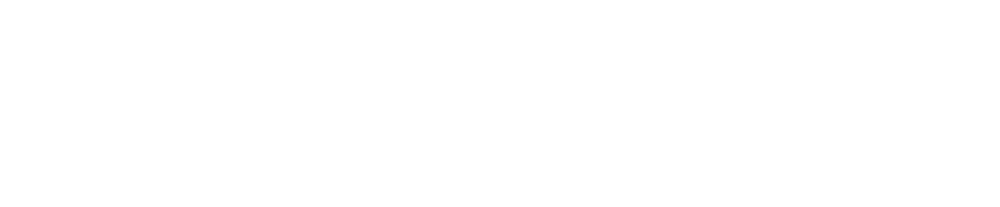

In [71]:
df.info(show_counts = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4635837 entries, 0 to 4635836
Data columns (total 9 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   event_time     4635837 non-null  object 
 1   event_type     4635837 non-null  object 
 2   product_id     4635837 non-null  int64  
 3   category_id    4635837 non-null  int64  
 4   category_code  75748 non-null    object 
 5   brand          2649808 non-null  object 
 6   price          4635837 non-null  float64
 7   user_id        4635837 non-null  int64  
 8   user_session   4635024 non-null  object 
dtypes: float64(1), int64(3), object(5)
memory usage: 318.3+ MB


In [72]:
group_columns = ['user_session','event_time','product_id','event_time']

df_grouped = df.groupby(by = group_columns)['user_session'].count().sort_values(ascending=False)

In [73]:
qtd_antes = df.shape

In [74]:
qtd_final = df[group_columns].drop_duplicates().shape

In [75]:
linhas_removidas = qtd_antes[0] - qtd_final[0]
print ('Linhas removidas:', linhas_removidas)
print ('Qtd Final:', qtd_final) 

Linhas removidas: 248572
Qtd Final: (4387265, 4)


In [76]:
df = df.drop_duplicates()

In [77]:
df.groupby(by = group_columns)['user_session'].count().sort_values(ascending=False)

user_session                          event_time               product_id  event_time             
363d868d-1fa5-4118-bb63-75ff43f2f1be  2019-11-29 11:31:30 UTC  5804660     2019-11-29 11:31:30 UTC    2
8636a0ea-0526-4829-a971-b5ac3f857c3f  2019-11-21 15:04:44 UTC  5834738     2019-11-21 15:04:44 UTC    2
dd707ef2-e05a-48ea-3ce6-ec54a6058060  2019-11-17 17:38:51 UTC  5700037     2019-11-17 17:38:51 UTC    2
                                      2019-11-17 17:37:56 UTC  5700030     2019-11-17 17:37:56 UTC    2
54859efe-2ebc-4a38-821c-2ced4150446f  2019-11-20 14:04:09 UTC  5863095     2019-11-20 14:04:09 UTC    2
                                                                                                     ..
55a1afe8-fb45-4b3b-85ad-17e357e0571a  2019-11-06 04:58:35 UTC  5848036     2019-11-06 04:58:35 UTC    1
                                      2019-11-06 04:58:37 UTC  5848036     2019-11-06 04:58:37 UTC    1
                                      2019-11-06 04:58:38 UTC  584803

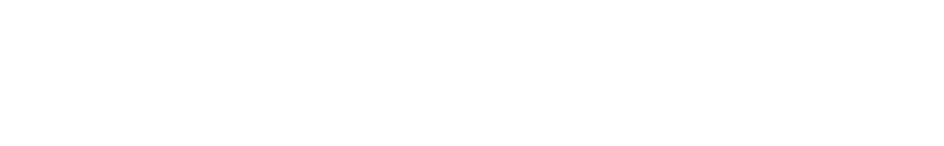

In [78]:
# df['event_time'] = pd.to_datetime(df['event_time'], format='%Y-%m-%d ')
df['event_time'] = pd.to_datetime(df['event_time'].astype(str), format="%Y-%m-%d %H:%M:%S %Z") 

In [79]:
# df.event_time.sample()
df['event_time'].sample(10)

1101736   2019-11-08 17:18:09+00:00
387828    2019-11-04 09:12:50+00:00
3719413   2019-11-25 17:09:20+00:00
729169    2019-11-06 14:44:00+00:00
1361268   2019-11-10 19:00:40+00:00
1916459   2019-11-14 20:44:49+00:00
3483591   2019-11-24 11:45:48+00:00
3204326   2019-11-22 21:57:41+00:00
4478349   2019-11-30 02:07:43+00:00
3475256   2019-11-24 10:58:20+00:00
Name: event_time, dtype: datetime64[ns, UTC]

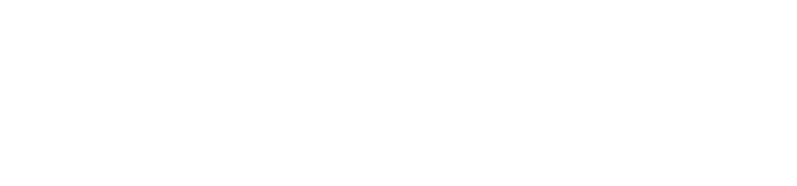

In [80]:
df['brand'].value_counts()

runail       304915
grattol      192985
irisk        191367
masura       173282
bpw.style    123356
              ...  
shifei            3
macadamia         2
footlogix         2
dessata           2
ibd               1
Name: brand, Length: 239, dtype: int64

In [81]:
df['brand'].isna().value_counts()

False    2509185
True     1879959
Name: brand, dtype: int64

In [82]:
df = df.dropna(subset=['brand'])

In [83]:
df

,event_time,event_type,product_id,category_id,category_code,brand,price,user_id,user_session
2,2019-11-01 00:00:10+00:00,view,5837166,1783999064103190764,NaN,pnb,22.22,556138645,57ed222e-a54a-4907-9944-5a875c2d7f4f
3,2019-11-01 00:00:11+00:00,cart,5876812,1487580010100293687,NaN,jessnail,3.16,564506666,186c1951-8052-4b37-adce-dd9644b1d5f7
6,2019-11-01 00:00:25+00:00,view,5856189,1487580009026551821,NaN,runail,15.71,562076640,09fafd6c-6c99-46b1-834f-33527f4de241
8,2019-11-01 00:00:34+00:00,remove_from_cart,5870838,1487580007675986893,NaN,milv,0.79,429913900,2f0bff3c-252f-4fe6-afcd-5d8a6a92839a
9,2019-11-01 00:00:37+00:00,view,5870803,1487580007675986893,NaN,milv,0.79,429913900,2f0bff3c-252f-4fe6-afcd-5d8a6a92839a
...,...,...,...,...,...,...,...,...,...
4635828,2019-11-30 23:59:27+00:00,remove_from_cart,5801131,1487580005486560104,NaN,irisk,3.65,566513990,b5053009-b3c4-4581-b05f-6199d1a2037e
4635830,2019-11-30 23:59:32+00:00,view,5795387,1487580005713052531,NaN,ingarden,7.14,576802932,2dc9ed07-93bb-47db-abe7-e9d88ed7ae94
4635833,2019-11-30 23:59:47+00:00,view,5733064,1487580004832248652,NaN,beautix,9.37,422196217,ab5e6dd5-8700-4ecc-a300-9f1eca5d1a95
4635834,2019-11-30 23:59:47+00:00,view,5867785,1487580007835370453,NaN,kims,31.10,572579084,d42865b7-7e04-4038-9be0-a59165625f06


In [84]:
df['price'].isna().value_counts()

False    2509185
Name: price, dtype: int64

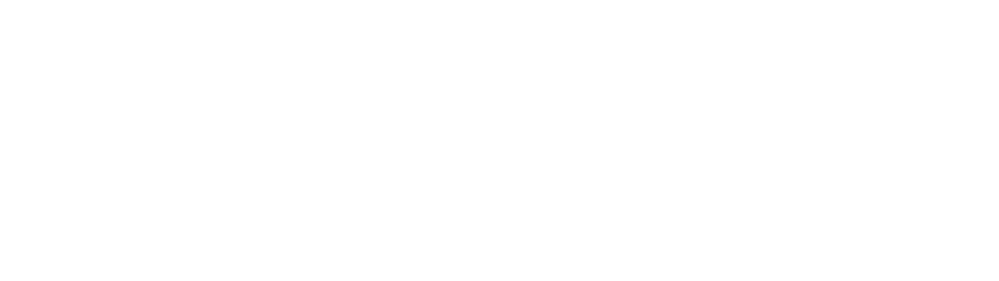

In [85]:
df = df.dropna(subset=['price'])

In [86]:
quantiles = [.01, .1, .25, .50, .75, .99]
for quantile in quantiles:
  value = df['price'].quantile(quantile)
  print (f'Quantile {quantile}:\t {value}')

Quantile 0.01:	 0.32
Quantile 0.1:	 0.95
Quantile 0.25:	 1.9
Quantile 0.5:	 4.0
Quantile 0.75:	 6.75
Quantile 0.99:	 122.22


In [87]:
iqr = df['price'].quantile(.75) - df['price'].quantile(.25)
print(f"IQR: {iqr}")

IQR: 4.85


In [88]:
upper_bound = df['price'].quantile(.75) + 1.5 * iqr
lower_bound = df['price'].quantile(.25) - 1.5 * iqr

print(f"upper_bound: {upper_bound}")
print(f"lower_bound: {lower_bound}")

upper_bound: 14.024999999999999
lower_bound: -5.375


In [89]:
df['price'].describe(percentiles=quantiles)

count    2.509185e+06
mean     9.252832e+00
std      2.128785e+01
min      0.000000e+00
1%       3.200000e-01
10%      9.500000e-01
25%      1.900000e+00
50%      4.000000e+00
75%      6.750000e+00
99%      1.222200e+02
max      3.277800e+02
Name: price, dtype: float64

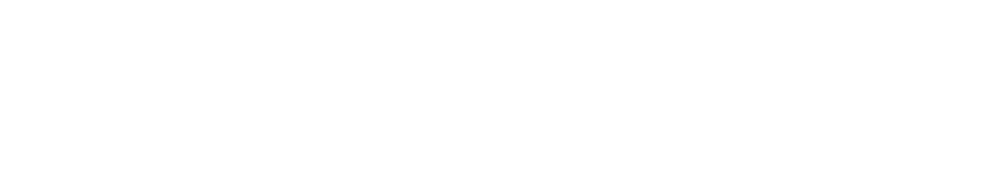

In [90]:
df['event_type'].isna().value_counts()

False    2509185
Name: event_type, dtype: int64

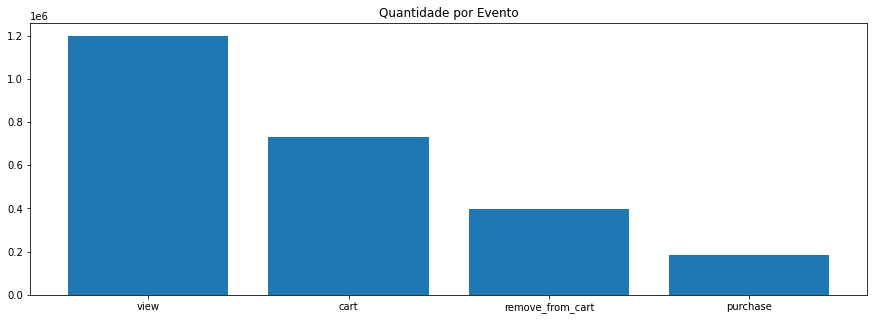

In [91]:
plt.figure(figsize=(15,5))

plt.bar(df['event_type'].value_counts().index, df['event_type'].value_counts())
plt.title('Quantidade por Evento');

# plt.figure(figsize=(7,4))
# df[['loja_cidade','tempo_pg']].groupby('loja_cidade').boxplot('tempo_pg')
# plt.title('Tempo de Pgto po Cidade')
# plt.xticks(rotation=90)
plt.show(); 

In [102]:
# fig = px.bar(df, x='event_type'].value_counts().index, y=df['event_type'].value_counts())
# # fig.show()

# fig = px.bar(data_canada, x='year', y='pop')
# fig.show()

# fig

fig = px.histogram(df, x="event_type")
fig.show()

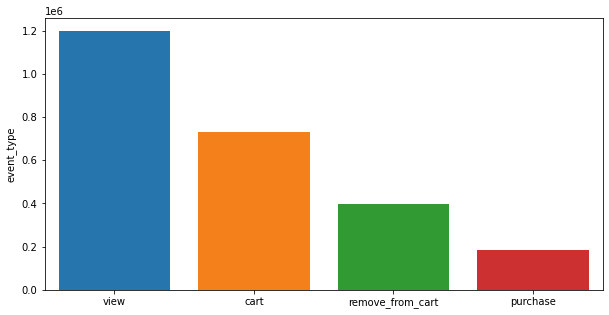

In [103]:
fig, ax = plt.subplots(figsize=(10, 5))

x = df['event_type'].value_counts().index
y = df['event_type'].value_counts()

sns.barplot(
    x=x,
    y=y,
    ax=ax,
    saturation=0.9,
    order=['view', 'cart', 'remove_from_cart', 'purchase']) 

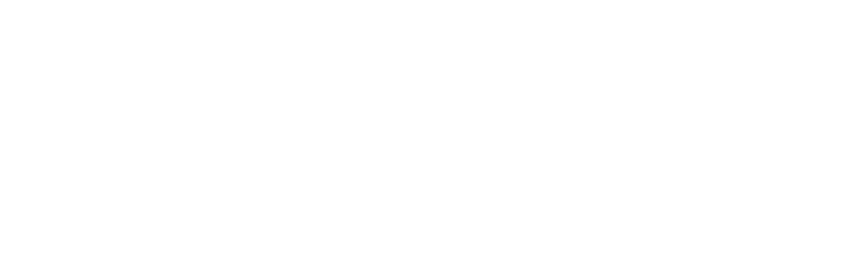

In [92]:
plot_df = df[df['event_type'] == 'purchase']

In [93]:
brand_df = plot_df['brand'].value_counts().to_frame().reset_index()

In [94]:
brand_df.columns = ['Marca', 'Quantidade']

In [95]:
top5 = brand_df.sort_values(by='Quantidade', ascending=False).head(5)

In [96]:
top5

,Marca,Quantidade
0,runail,25997
1,irisk,16364
2,grattol,13613
3,bpw.style,12985
4,masura,11435


In [104]:
brand_df.head(5)

,Marca,Quantidade
0,runail,25997
1,irisk,16364
2,grattol,13613
3,bpw.style,12985
4,masura,11435


In [98]:
fig = px.bar(top5, x='Marca', y='Quantidade')
fig.show()